<a href="https://colab.research.google.com/github/AHajibalayev/CNN--GAN/blob/main/Ahmadagha_HAJIBALAYEV_MV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<center>

**Machine Vision Project - Generative Adversarial Networks
Data augmentation**

Ahmadagha HAJIBALAYEV - 20235122

*Université Paris-Saclay - M1 International track in Electrical Engineering*
</center>


In [ ]:
#import data from google drive
from google.colab import drive
drive.mount('/content/drive')

#Load Libraries
import os
import numpy as np
import torch
import glob
#using pytorch functions
import torch.nn as nn
from torchvision.transforms import transforms
from torch.utils.data import DataLoader
from torch.optim import Adam
from torch.autograd import Variable
import torchvision
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils

import pathlib
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import argparse
import random
import matplotlib.animation as animation
from IPython.display import HTML

# different results
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(False)




Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Checking for the device

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


Transforms


In [ ]:
# Resize to be shure using images with same size
transformer = transforms.Compose([transforms.Resize((256,256)),
                                  transforms.RandomHorizontalFlip(),transforms.ToTensor(),
                                  transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])])
# numpy to tensors to (x- mean)/ std

Loading the Data

In [ ]:
train_path = '/content/drive/MyDrive/Newdata/Train'
test_path = '/content/drive/MyDrive/Newdata/Test'
train_loader = DataLoader(torchvision.datasets.ImageFolder(train_path,transform=transformer), batch_size=256, shuffle= True)
test_loader = DataLoader(torchvision.datasets.ImageFolder(test_path,transform=transformer), batch_size=256, shuffle= True)

Classes in the Dataset

In [ ]:
root = pathlib.Path(train_path)
classes = sorted([j.name.split('/')[-1] for j in root.iterdir()])
print(classes)

['Cow', 'Horse']


CNN NETWORK


In [ ]:
class ConvNet(nn.Module):
  def __init__(self,num_classes=6):
    super(ConvNet,self).__init__()

    # inputshape (256,3,256,256)    ((256-3+2)/1)+1 =256
    self.conv1 = nn.Conv2d(in_channels=3,out_channels=12,kernel_size=3,stride=1,padding=1)
    # (256,12,256,256)
    self.bn1 = nn.BatchNorm2d(num_features=12)
    # shape (256,12,256,256) reamin same
    self.relu1 = nn.ReLU()
    # shape (256,12,256,256) remain same

    self.pool = nn.MaxPool2d(kernel_size=2)
    # shape (256,12,128,128) reduced size

    self.conv2 = nn.Conv2d(in_channels=12,out_channels=20,kernel_size=3,stride=1,padding=1)
    # shape (256,20,128,128)
    self.relu2 = nn.ReLU()


    self.conv3 = nn.Conv2d(in_channels=20,out_channels=32,kernel_size=3,stride=1,padding=1)
    # shape (256,32,128,128)
    self.bn3 = nn.BatchNorm2d(num_features=32)
    self.relu3 = nn.ReLU()

    # fully connected layer
    self.fc = nn.Linear(in_features=32*128*128, out_features=num_classes)


    # forvard function

  def forward(self,input):
    output = self.conv1(input)
    output = self.bn1(output)
    output = self.relu1(output)

    output = self.pool(output)

    output = self.conv2(output)
    output = self.relu2(output)

    output = self.conv3(output)
    output = self.bn3(output)
    output = self.relu3(output)
    # reshaping into 1D array
    output = output.view(-1,32*128*128)
    output = self.fc(output)

    return output



In [ ]:
model=ConvNet(num_classes=2).to(device)
optimizer = Adam(model.parameters(), lr=0.001,weight_decay=0.0001)
loss_function = nn.CrossEntropyLoss()
train_count = len(glob.glob(train_path+'/**/*.png'))
test_count = len(glob.glob(test_path+'/**/*.png'))
print(train_count,test_count) # count of the images

82 82


In [ ]:
num_epochs = 15

for epoch in range(num_epochs):

  # with training data
    model.train()

    train_accuracy = 0.0
    train_loss = 0.0

    for i, (images, labels) in enumerate(train_loader):
        if torch.cuda.is_available():
            images = Variable(images.cuda())
            labels = Variable(labels.cuda())

        optimizer.zero_grad()

        outputs = model(images)
        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.cpu().data * images.size(0)
        _, prediction = torch.max(outputs.data, 1)

        train_accuracy += int(torch.sum(prediction == labels.data))

    train_accuracy = train_accuracy / train_count
    train_loss = train_loss / train_count


  # testing data
    model.eval()

    test_accuracy = 0.0
    test_loss = 0.0

    for i, (images, labels) in enumerate(test_loader):
        if torch.cuda.is_available():
            images = Variable(images.cuda())
            labels = Variable(labels.cuda())

        outputs = model(images)

        _, prediction = torch.max(outputs.data, 1)

        test_accuracy += int(torch.sum(prediction == labels.data))

        test_loss += loss_function(outputs, labels).cpu().data * images.size(0)

    test_accuracy = test_accuracy / test_count
    test_loss = test_loss / test_count

    print('Epoch: ' + str(epoch) + ' Train Loss: ' + str(int(train_loss)) + ' Train Accuracy: ' + str(train_accuracy) + ' Test Accuracy: ' + str(test_accuracy) + ' Test Loss: ' + str(int(test_loss)))


Epoch: 0 Train Loss: 0 Train Accuracy: 0.524390243902439 Test Accuracy: 0.5 Test Loss: 2
Epoch: 1 Train Loss: 0 Train Accuracy: 0.975609756097561 Test Accuracy: 0.5 Test Loss: 2
Epoch: 2 Train Loss: 7 Train Accuracy: 0.7804878048780488 Test Accuracy: 0.5 Test Loss: 3
Epoch: 3 Train Loss: 2 Train Accuracy: 0.9634146341463414 Test Accuracy: 0.5 Test Loss: 8
Epoch: 4 Train Loss: 9 Train Accuracy: 0.8902439024390244 Test Accuracy: 0.5 Test Loss: 11
Epoch: 5 Train Loss: 5 Train Accuracy: 0.926829268292683 Test Accuracy: 0.5 Test Loss: 11
Epoch: 6 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.5 Test Loss: 10
Epoch: 7 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.5 Test Loss: 8
Epoch: 8 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.5121951219512195 Test Loss: 6
Epoch: 9 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.5121951219512195 Test Loss: 3
Epoch: 10 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.45121951219512196 Test Loss: 2
Epoch: 11 Train Loss: 0 Train Accuracy

Calculating the Predictions of Each Classes

In [ ]:
true_pred = {classname: 0 for classname in classes}
all_pred = {classname: 0 for classname in classes}

with torch.no_grad():
  for images, labels in test_loader:
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    _, predictions = torch.max(outputs, 1)


    for label, prediction in zip(labels, predictions):
      if label == prediction:
        true_pred[classes[label]] += 1
      all_pred[classes[label]] += 1



for classname, i in true_pred.items():
  accuracy = 100 * float(i) / all_pred[classname]
  print(f'Accuracy of {classname} : {accuracy} %')

Accuracy of Cow : 87.8048780487805 %
Accuracy of Horse : 21.951219512195124 %


Visualize the Images

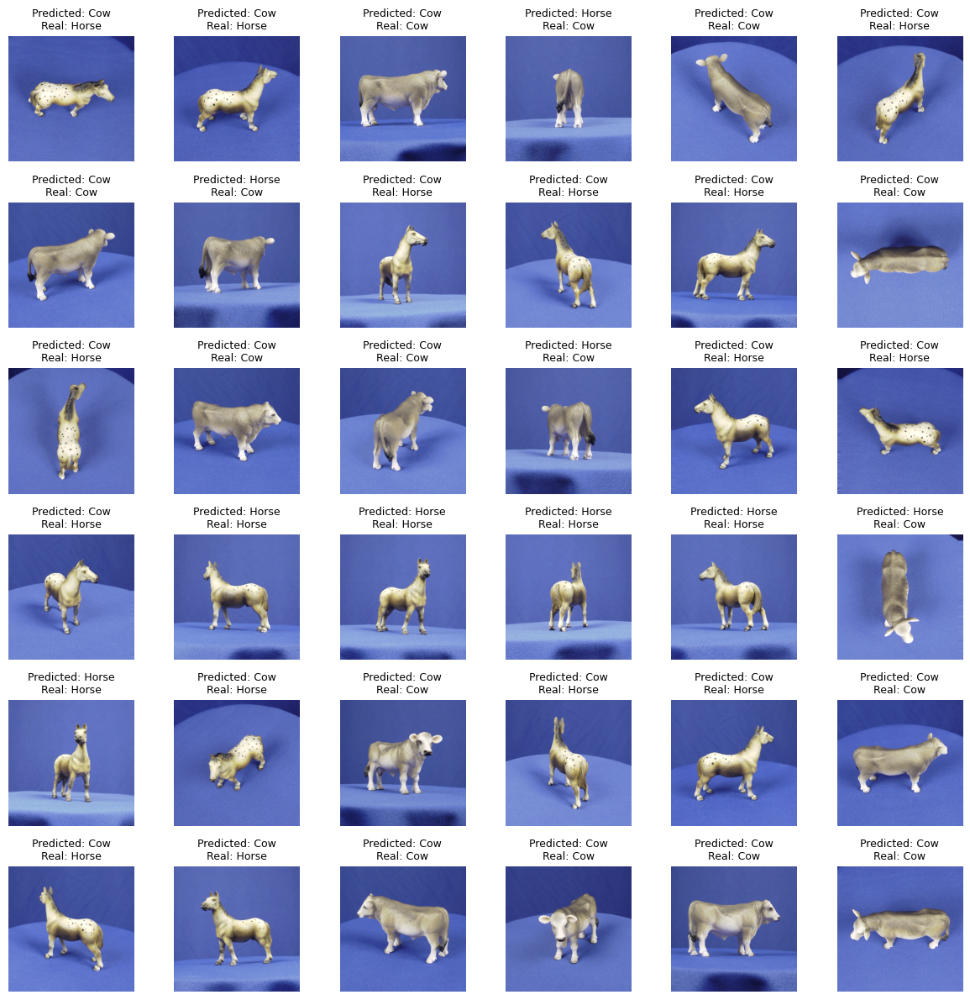

In [ ]:
def visualize_predictions(model, device, data_loader, num_images=36):
    model.eval()
    images, labels = next(iter(data_loader))
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        outputs = model(images)
    _, predicted = torch.max(outputs, 1)

    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        ax = plt.subplot(6, 6, i + 1)  # 36 images 6by6
        img = images[i].cpu().numpy().transpose((1, 2, 0))
        img = (img + 1) / 2
        plt.imshow(img)
        ax.set_title(f'Predicted: {classes[predicted[i]]}\nReal: {classes[labels[i]]}', fontsize=9)
        plt.axis('off')


    plt.tight_layout()
    plt.show()


visualize_predictions(model, device, test_loader, 36)

**Generative Adversarial Networks**


In [ ]:
torch.use_deterministic_algorithms(True) # Reproducible results

# Root directory for dataset
dataroot = '/content/drive/MyDrive/Newdata/Train'
cow_root = '/content/drive/MyDrive/Newdata2/cowdc'
horse_root ='/content/drive/MyDrive/Newdata2/horsedc'


workers = 2 # Number of workers for dataloader

batch_size = 8 # Batch size during training

image_size = 64

nc = 3 # Number of channels in the training images.(RGB)

nz = 100 # Size of z latent vector

ngf = 64 # Size of feature maps in generator

ndf = 64 # Size of feature maps in discriminator

num_epochs = 500 # Number of training epochs

lr = 0.0002 # Learning rate for optimizers

beta1 = 0.5 # Beta1 hyperparameter for Adam optimizers

ngpu = 1 # Number of GPUs available.

DCGAN For COW

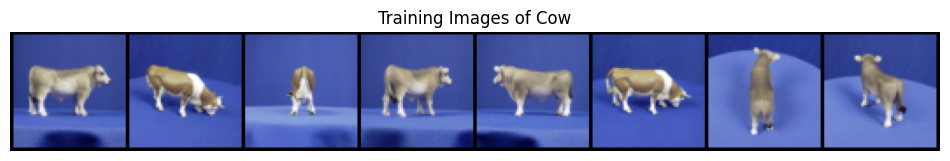

In [ ]:

dataset = dset.ImageFolder(root=cow_root,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
#dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# device
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(12,12))
plt.axis("off")
plt.title("Training Images of Cow")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
# weights initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Generator
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True), # (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True), # (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),  # (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True), # (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()# (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Here CUDA is needed
netG = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(# (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True), # (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),# (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True), # (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True), # (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Here CUDA is needed
netD = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# BCE loss function
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
# Lists to keep track of progress
img_list = []  # Store generated images for visualization
G_losses = []  # Store generator losses
D_losses = []  # Store discriminator losses
iters = 0  # Counter for iterations

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        # Update Discriminator
        netD.zero_grad()  # Reset discriminator gradients
        # Format batch
        real_cpu = data[0].to(device)  # Move real images to device
        b_size = real_cpu.size(0)  # Get batch size
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)  # Create labels for real images

        # Forward pass real batch through discriminator
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)  # Calculate loss with real images
        errD_real.backward()  # Backpropagate gradients
        D_x = output.mean().item()  # Get average output for real images

        # Generate fake images
        noise = torch.randn(b_size, nz, 1, 1, device=device)  # Generate random noise
        fake = netG(noise)  # Generate fake images
        label.fill_(fake_label)  # Fill labels with fake labels

        # Forward pass fake batch through discriminator (detach from generator)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)  # Calculate loss with fake images
        errD_fake.backward()  # Backpropagate gradients
        D_G_z1 = output.mean().item()  # Get average output for fake images

        errD = errD_real + errD_fake  # Total discriminator loss
        optimizerD.step()  # Update discriminator parameters

        # Update Generator
        netG.zero_grad()  # Reset generator gradients
        label.fill_(real_label)  # Fill labels with real labels

        # Forward pass fake batch through discriminator again (not detached)
        output = netD(fake).view(-1)
        errG = criterion(output, label)  # Calculate generator loss
        errG.backward()  # Backpropagate gradients
        D_G_z2 = output.mean().item()  # Get average output for fake images after generator update

        optimizerG.step()  # Update generator parameters

        # Print and store losses
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        G_losses.append(errG.item())  # Store generator loss
        D_losses.append(errD.item())  # Store discriminator loss

        # Save generated images at certain intervals
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()  # Generate fake images with fixed noise
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))  # Make grid of fake images for visualization

        iters += 1  # Increment iteration counter


[0/500][0/11]	Loss_D: 2.4418	Loss_G: 6.4641	D(x): 0.4243	D(G(z)): 0.6284 / 0.0020
[1/500][0/11]	Loss_D: 0.1196	Loss_G: 7.1708	D(x): 0.9781	D(G(z)): 0.0901 / 0.0009
[2/500][0/11]	Loss_D: 0.0302	Loss_G: 6.5883	D(x): 0.9893	D(G(z)): 0.0188 / 0.0019
[3/500][0/11]	Loss_D: 0.0528	Loss_G: 8.9831	D(x): 0.9999	D(G(z)): 0.0483 / 0.0002
[4/500][0/11]	Loss_D: 0.0625	Loss_G: 11.3815	D(x): 0.9972	D(G(z)): 0.0557 / 0.0000
[5/500][0/11]	Loss_D: 0.4486	Loss_G: 26.4278	D(x): 0.9999	D(G(z)): 0.2669 / 0.0000
[6/500][0/11]	Loss_D: 0.0848	Loss_G: 14.8510	D(x): 0.9929	D(G(z)): 0.0708 / 0.0000
[7/500][0/11]	Loss_D: 0.0011	Loss_G: 18.4903	D(x): 0.9989	D(G(z)): 0.0000 / 0.0000
[8/500][0/11]	Loss_D: 0.0358	Loss_G: 18.3987	D(x): 0.9677	D(G(z)): 0.0000 / 0.0000
[9/500][0/11]	Loss_D: 0.0000	Loss_G: 21.7980	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[10/500][0/11]	Loss_D: 0.0681	Loss_G: 32.8208	D(x): 0.9464	D(G(z)): 0.0000 / 0.0000
[11/500][0/11]	Loss_D: 0.0506	Loss_G: 12.8845	D(x): 0.9968	D(G(z)): 0.0416 / 0.0000
[12/50

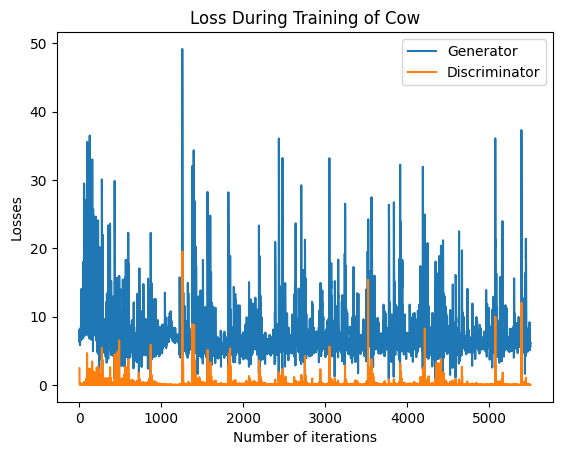

In [ ]:
plt.title("Loss During Training of Cow")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("Number of iterations")
plt.ylabel("Losses")
plt.legend()
plt.show()

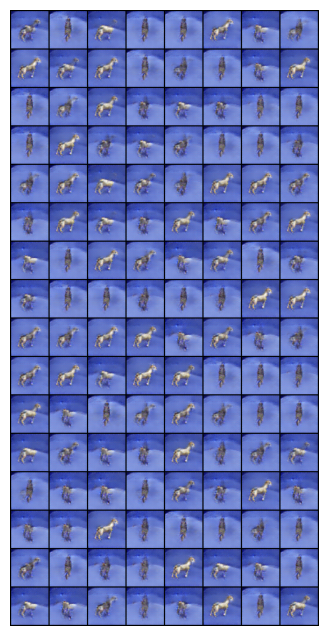

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


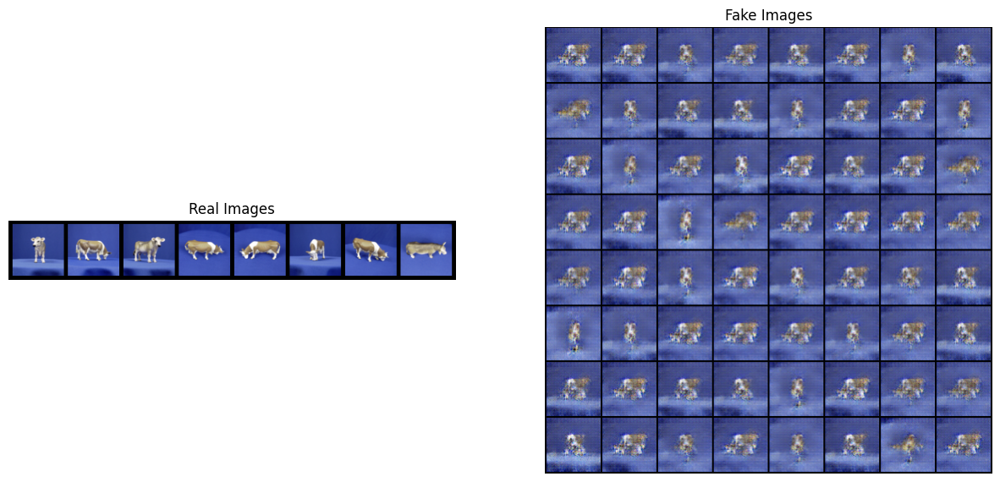

In [ ]:
real_batch = next(iter(dataloader))

# real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [ ]:
# creating 128 images
noise = torch.randn(128, nz, 1, 1, device=device)
with torch.no_grad():
    fake = netG(noise).detach().cpu()
img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

In [ ]:
# saving images into the new folder
from PIL import Image

def save_img(original_img, num_img, output_dir='/content/drive/MyDrive/DC/Cow'):
    os.makedirs(output_dir, exist_ok=True)

    original_img = np.transpose(original_img[-1].cpu().detach().numpy(), (1, 2, 0))
    original_img = original_img * 255.0
    original_img = original_img.astype(np.uint8)
    original_img = Image.fromarray(original_img)

    width, height = original_img.size
    y_num = num_img / 8
    step_x = width // 8
    step_y = height // y_num

    for i in range(int(y_num)):
      for j in range(8):
        left = j * step_x
        upper = i * step_y
        right = left + step_x
        lower = upper + step_y
        sub_image = original_img.crop((left, upper, right, lower))

        sub_image.save(os.path.join(output_dir, f'cow_fake_{i*8+j}.png'))
save_img(img_list, 128)

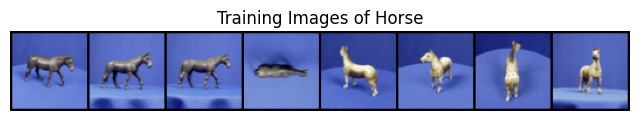

In [ ]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset


dataset = dset.ImageFolder(root=horse_root,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images of Horse")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [ ]:
# Lists to keep track of progress
img_list = []  # Store generated images for visualization
G_losses = []  # Store generator losses
D_losses = []  # Store discriminator losses
iters = 0  # Counter for iterations

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        # Update Discriminator
        netD.zero_grad()  # Reset discriminator gradients
        # Format batch
        real_cpu = data[0].to(device)  # Move real images to device
        b_size = real_cpu.size(0)  # Get batch size
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)  # Create labels for real images

        # Forward pass real batch through discriminator
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)  # Calculate loss with real images
        errD_real.backward()  # Backpropagate gradients
        D_x = output.mean().item()  # Get average output for real images

        # Generate fake images
        noise = torch.randn(b_size, nz, 1, 1, device=device)  # Generate random noise
        fake = netG(noise)  # Generate fake images
        label.fill_(fake_label)  # Fill labels with fake labels

        # Forward pass fake batch through discriminator (detach from generator)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)  # Calculate loss with fake images
        errD_fake.backward()  # Backpropagate gradients
        D_G_z1 = output.mean().item()  # Get average output for fake images

        errD = errD_real + errD_fake  # Total discriminator loss
        optimizerD.step()  # Update discriminator parameters

        # Update Generator
        netG.zero_grad()  # Reset generator gradients
        label.fill_(real_label)  # Fill labels with real labels

        # Forward pass fake batch through discriminator again (not detached)
        output = netD(fake).view(-1)
        errG = criterion(output, label)  # Calculate generator loss
        errG.backward()  # Backpropagate gradients
        D_G_z2 = output.mean().item()  # Get average output for fake images after generator update

        optimizerG.step()  # Update generator parameters

        # Print and store losses
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        G_losses.append(errG.item())  # Store generator loss
        D_losses.append(errD.item())  # Store discriminator loss

        # Save generated images at certain intervals
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()  # Generate fake images with fixed noise
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))  # Make grid of fake images for visualization

        iters += 1  # Increment iteration counter


[0/500][0/11]	Loss_D: 15.7445	Loss_G: 0.0193	D(x): 0.0000	D(G(z)): 0.0050 / 0.9809
[1/500][0/11]	Loss_D: 0.0157	Loss_G: 6.8664	D(x): 0.9906	D(G(z)): 0.0059 / 0.0014
[2/500][0/11]	Loss_D: 0.1365	Loss_G: 9.1093	D(x): 0.9912	D(G(z)): 0.1036 / 0.0003
[3/500][0/11]	Loss_D: 0.0418	Loss_G: 20.2305	D(x): 0.9616	D(G(z)): 0.0017 / 0.0001
[4/500][0/11]	Loss_D: 0.3410	Loss_G: 7.9039	D(x): 0.8176	D(G(z)): 0.0003 / 0.0007
[5/500][0/11]	Loss_D: 0.5327	Loss_G: 7.8621	D(x): 0.7712	D(G(z)): 0.0875 / 0.0008
[6/500][0/11]	Loss_D: 1.3310	Loss_G: 8.3074	D(x): 0.9916	D(G(z)): 0.3635 / 0.0057
[7/500][0/11]	Loss_D: 0.2474	Loss_G: 7.2641	D(x): 0.8394	D(G(z)): 0.0152 / 0.0134
[8/500][0/11]	Loss_D: 0.0238	Loss_G: 12.2314	D(x): 0.9787	D(G(z)): 0.0008 / 0.0000
[9/500][0/11]	Loss_D: 1.5212	Loss_G: 10.9509	D(x): 1.0000	D(G(z)): 0.5312 / 0.0001
[10/500][0/11]	Loss_D: 0.5512	Loss_G: 3.9928	D(x): 0.8038	D(G(z)): 0.1102 / 0.0423
[11/500][0/11]	Loss_D: 0.0867	Loss_G: 6.2499	D(x): 0.9592	D(G(z)): 0.0426 / 0.0027
[12/500][0

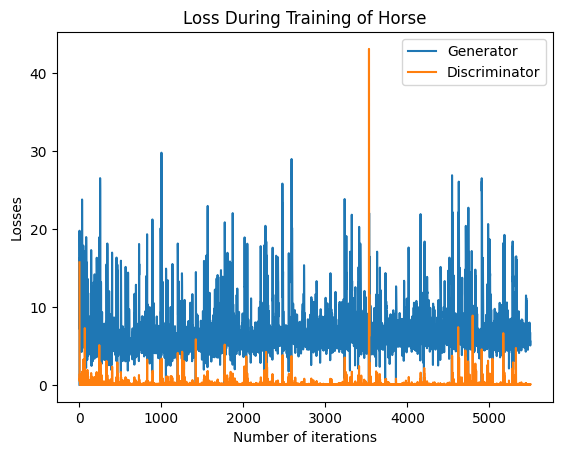

In [ ]:
plt.title("Loss During Training of Horse")
plt.plot(G_losses,label="Generator")
plt.plot(D_losses,label="Discriminator")
plt.xlabel("Number of iterations")
plt.ylabel("Losses")
plt.legend()
plt.show()

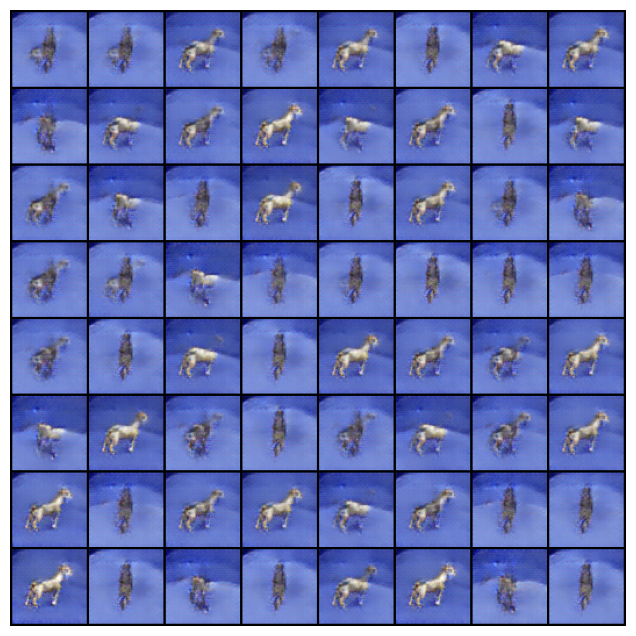

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


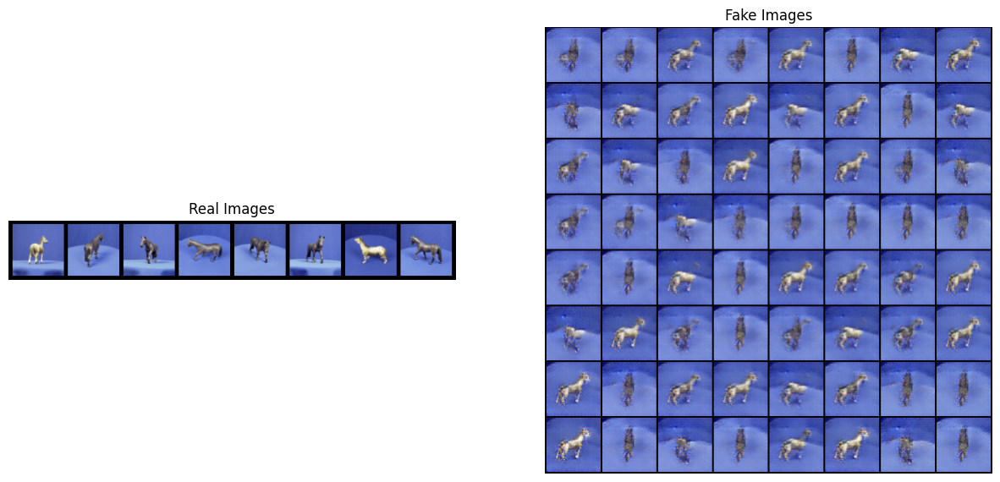

In [ ]:
real_batch = next(iter(dataloader))

# real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

#fake images
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [ ]:
# generating 128 fake images
noise = torch.randn(128, nz, 1, 1, device=device)
with torch.no_grad():
    fake = netG(noise).detach().cpu()
img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

In [ ]:
from PIL import Image

# saving pictures to the new folder in drive
def save_img(original_img, num_img, output_dir='/content/drive/MyDrive/DC/Horse'):
    os.makedirs(output_dir, exist_ok=True)

    original_img = np.transpose(original_img[-1].cpu().detach().numpy(), (1, 2, 0))
    original_img = original_img * 255.0
    original_img = original_img.astype(np.uint8)
    original_img = Image.fromarray(original_img)

    width, height = original_img.size
    y_num = num_img / 8
    step_x = width // 8
    step_y = height // y_num

    for i in range(int(y_num)):
      for j in range(8):
        left = j * step_x
        upper = i * step_y
        right = left + step_x
        lower = upper + step_y
        sub_image = original_img.crop((left, upper, right, lower))

        sub_image.save(os.path.join(output_dir, f'horse_fake_{i*8+j}.png'))
save_img(img_list, 128)

In [ ]:
# seed for reproducibility
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(False) # for reproducible results

# We can use an image folder dataset the way we have it setup.
transformer = transforms.Compose([transforms.Resize((256,256)), transforms.RandomHorizontalFlip(),transforms.ToTensor(),transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])])


# Creating new dataset the dataset
batch_size = 16
transform= transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Resize(64),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
                               ])
train_data= dset.ImageFolder(root= train_path, transform=transform)
trainloader= torch.utils.data.DataLoader(train_data, shuffle=True, batch_size=16)

test_data= dset.ImageFolder(root=test_path, transform=transform)
testloader= torch.utils.data.DataLoader(test_data, shuffle=True, batch_size=16)

generated_data= dset.ImageFolder(root="/content/drive/MyDrive/DC", transform=transform)
generatedloader= torch.utils.data.DataLoader(generated_data, shuffle=True, batch_size=16)

classes= os.listdir(train_path)
image_sample= train_data[0]


#Combining both datasets
merged_dataset= torch.utils.data.ConcatDataset([train_data, generated_data])

# Create the dataloader for the merged dataset
merged_loader= torch.utils.data.DataLoader(merged_dataset, shuffle=True, batch_size=16)

In [ ]:
class ConvNet(nn.Module):
  def __init__(self,num_classes=6):
    super(ConvNet,self).__init__()

    # inputshape (256,3,256,256)    ((256-3+2)/1)+1 =256
    self.conv1 = nn.Conv2d(in_channels=3,out_channels=12,kernel_size=3,stride=1,padding=1)
    # (256,12,256,256)
    self.bn1 = nn.BatchNorm2d(num_features=12)
    # shape (256,12,256,256) reamin same
    self.relu1 = nn.ReLU()
    # shape (256,12,256,256) remain same

    self.pool = nn.MaxPool2d(kernel_size=2)
    # shape (256,12,128,128) reduced size

    self.conv2 = nn.Conv2d(in_channels=12,out_channels=20,kernel_size=3,stride=1,padding=1)
    # shape (256,20,128,128)
    self.relu2 = nn.ReLU()


    self.conv3 = nn.Conv2d(in_channels=20,out_channels=32,kernel_size=3,stride=1,padding=1)
    # shape (256,32,128,128)
    self.bn3 = nn.BatchNorm2d(num_features=32)
    self.relu3 = nn.ReLU()

    # fully connected layer
    self.fc = nn.Linear(in_features=32*128*128, out_features=num_classes)


    # forvard function

  def forward(self,input):
    output = self.conv1(input)
    output = self.bn1(output)
    output = self.relu1(output)

    output = self.pool(output)

    output = self.conv2(output)
    output = self.relu2(output)

    output = self.conv3(output)
    output = self.bn3(output)
    output = self.relu3(output)

    output = output.view(-1,32*128*128)
    output = self.fc(output)

    return output



In [ ]:
model=ConvNet(num_classes=2).to(device)
optimizer = Adam(model.parameters(), lr=0.001,weight_decay=0.0001)
loss_function = nn.CrossEntropyLoss()
num_epochs = 10

In [ ]:
torch.use_deterministic_algorithms(False)
generated_data = dset.ImageFolder(root="/content/drive/MyDrive/DC", transform=transformer)
generated_loader = torch.utils.data.DataLoader(generated_data, shuffle=True, batch_size=16)
merged_dataset = torch.utils.data.ConcatDataset([train_loader.dataset, generated_data]) #merged the training data with the fake data

train_loader = DataLoader(merged_dataset, batch_size=16, shuffle=True)

train_count = len(train_loader.dataset)  # Update the train_count

for epoch in range(num_epochs):

  # Training classification
    model.train()

    train_accuracy = 0.0
    train_loss = 0.0

    for i, (images, labels) in enumerate(train_loader):
        if torch.cuda.is_available():
            images = Variable(images.cuda())
            labels = Variable(labels.cuda())

        optimizer.zero_grad()

        outputs = model(images)
        loss = loss_function(outputs, labels)
        loss.backward()
        optimizer.step()

        train_loss += loss.cpu().data * images.size(0)
        _, prediction = torch.max(outputs.data, 1)

        train_accuracy += int(torch.sum(prediction == labels.data))

    train_accuracy = train_accuracy / train_count
    train_loss = train_loss / train_count

  # Testing classifier
    model.eval()

    test_accuracy = 0.0
    test_loss = 0.0

    for i, (images, labels) in enumerate(test_loader):
        if torch.cuda.is_available():
            images = Variable(images.cuda())
            labels = Variable(labels.cuda())

        outputs = model(images)

        _, prediction = torch.max(outputs.data, 1)

        test_accuracy += int(torch.sum(prediction == labels.data))

        test_loss += loss_function(outputs, labels).cpu().data * images.size(0)

    test_accuracy = test_accuracy / test_count
    test_loss = test_loss / test_count

    print('Epoch: ' + str(epoch) + ' Train Loss: ' + str(int(train_loss)) + ' Train Accuracy: ' + str(train_accuracy) + ' Test Accuracy: ' + str(test_accuracy) + ' Test Loss: ' + str(int(test_loss)))



Epoch: 0 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.6219512195121951 Test Loss: 128
Epoch: 1 Train Loss: 0 Train Accuracy: 0.9966329966329966 Test Accuracy: 0.6707317073170732 Test Loss: 92
Epoch: 2 Train Loss: 0 Train Accuracy: 0.9932659932659933 Test Accuracy: 0.6463414634146342 Test Loss: 175
Epoch: 3 Train Loss: 0 Train Accuracy: 0.9949494949494949 Test Accuracy: 0.6951219512195121 Test Loss: 109
Epoch: 4 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.6951219512195121 Test Loss: 98
Epoch: 5 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.7195121951219512 Test Loss: 113
Epoch: 6 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.6829268292682927 Test Loss: 109
Epoch: 7 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.7073170731707317 Test Loss: 122
Epoch: 8 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.6951219512195121 Test Loss: 122
Epoch: 9 Train Loss: 0 Train Accuracy: 1.0 Test Accuracy: 0.6707317073170732 Test Loss: 123


In [ ]:
true_pred = {classname: 0 for classname in classes}
all_pred = {classname: 0 for classname in classes}

with torch.no_grad():
  for images, labels in test_loader:
    images, labels = images.to(device), labels.to(device)
    outputs = model(images)
    _, predictions = torch.max(outputs, 1)


    for label, prediction in zip(labels, predictions):
      if label == prediction:
        true_pred[classes[label]] += 1
      all_pred[classes[label]] += 1



for classname, i in true_pred.items():
  accuracy = 100 * float(i) / all_pred[classname]
  print(f'Accuracy of {classname} : {accuracy} %')

Accuracy of Cow : 100.0 %
Accuracy of Horse : 36.58536585365854 %


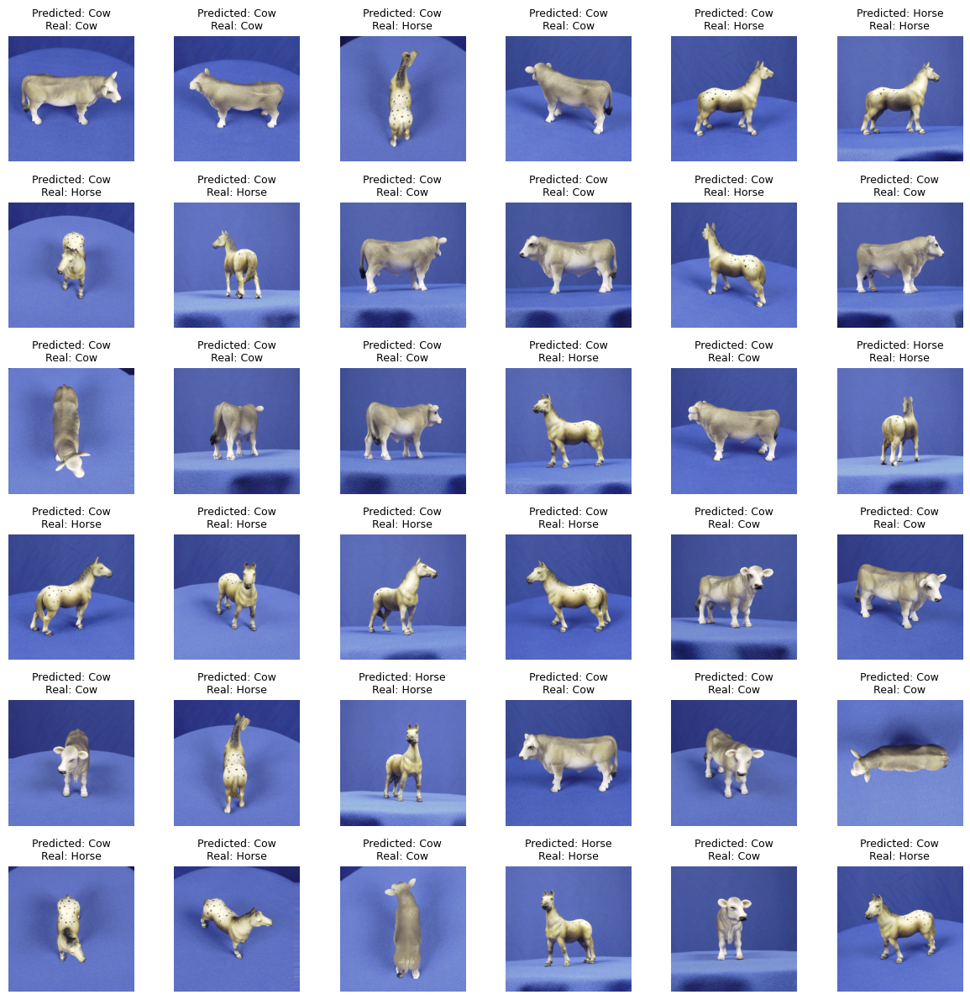

In [ ]:
def visualize_predictions(model, device, data_loader, num_images=36):
    model.eval()
    images, labels = next(iter(data_loader))
    images, labels = images.to(device), labels.to(device)
    with torch.no_grad():
        outputs = model(images)
    _, predicted = torch.max(outputs, 1)

    plt.figure(figsize=(12, 12))
    for i in range(num_images):
        ax = plt.subplot(6, 6, i + 1)  # 36 images 6by6
        img = images[i].cpu().numpy().transpose((1, 2, 0))
        img = (img + 1) / 2
        plt.imshow(img)
        ax.set_title(f'Predicted: {classes[predicted[i]]}\nReal: {classes[labels[i]]}', fontsize=9)
        plt.axis('off')


    plt.tight_layout()
    plt.show()


visualize_predictions(model, device, test_loader, 36)